In [11]:
%load_ext autoreload
%autoreload 2


#from deepgreen import *
import pandas as pd
import json
from dotenv import load_dotenv
import os
from pathlib import Path

from sentinelhub.api.catalog import SentinelHubCatalog

from sentinelhub import (
    SHConfig,
    CRS,
    BBox,
    BBoxSplitter,
    CustomGridSplitter,
    OsmSplitter,
    TileSplitter,
    UtmGridSplitter,
    UtmZoneSplitter,
    DataCollection,
    DownloadRequest,
    MimeType,
    MosaickingOrder,
    SentinelHubDownloadClient,
    SentinelHubRequest,
    read_data,
    bbox_to_dimensions,
)


#from functions.cloud_coverage_functions import *
from functions.html_table_functions import *
from functions.plot_functions import *
from functions.sentinel_hub_functions import *



The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [ ]:
# Init Config
load_dotenv()

CONFIG = SHConfig()
# TODO: Gaht nöd
CONFIG.sh_client_id = ''
CONFIG.sh_client_secret = ''


In [13]:
# Define area of intrest (Winterthur)
aoi = BBox(bbox = (8.629496, 47.421583, 8.884906,47.58301), 
              crs = CRS.WGS84)

# Segment area of intrest into smaller regions
aoi_wt_segments = segment_aoi(aoi = aoi, resolution = 10, output = "grid")

# Create aoi segment id to bbox map dict
aoi_bbox_dict = create_aoi_bbox_dict(aoi_wt_segments)

In [14]:
# Initialize Sentinelhub Catalog Object
catalog_obj = SentinelHubCatalog(config=CONFIG)

# Define time interval
time_intervall = "2025-03-01", "2025-04-20"

# create aoi catalog for specified time interval and store it as json file
aoi_catalog = create_aoi_catalog_dict(catalog = catalog_obj, 
                                      time_interval = time_intervall, 
                                      aoi_bbox_dict = aoi_bbox_dict, 
                                      save_file = True,
                                      file_name = "winterthur_2025_aoi_catalog.json",
                                      dir_path = Path("data")
                                      )

In [32]:
es = load_eval_script("evalscripts/es_all_bands_clm.js")

rows = []
for aoi_id in aoi_catalog.keys():
    id = aoi_id
    bbox = aoi_bbox_dict[id]
    timestamps = list(aoi_catalog[id].keys())
    for timestamp in timestamps:
        ts = str(timestamp)[:10] # extract date: 2025-04-20T10:37:59Z -> 2025-04-20
        img = get_img(evalscript = es, timestamp = ts, bbox = bbox, resolution = 10, config = CONFIG)
        row = [id, bbox, ts, img]
        rows.append(row)

df = pd.DataFrame(rows)

#### Download single image

In [17]:
id = '0000'
ts = '2025-04-08'
res = 10
bbox = aoi_bbox_dict[id]
bbox_size = bbox_to_dimensions(bbox, resolution=res)

##### rgb

In [23]:
es = load_eval_script("evalscripts/es_standard.js")

request_image = SentinelHubRequest(
    evalscript = es,
    input_data = [
        SentinelHubRequest.input_data(
            data_collection = DataCollection.SENTINEL2_L2A,
            time_interval = ts,
        )
    ],
    responses = [SentinelHubRequest.output_response("default", MimeType.TIFF)],
    bbox = bbox,
    size = bbox_size,
    config = CONFIG,
)
imgs_rgb = request_image.get_data()
img_rgbX =  imgs_rgb[0]

##### all bands

In [18]:
es = load_eval_script("evalscripts/es_all_bands_clm.js")

request_image = SentinelHubRequest(
    evalscript = es,
    input_data = [
        SentinelHubRequest.input_data(
            data_collection = DataCollection.SENTINEL2_L2A,
            time_interval = ts,
        )
    ],
    responses = [SentinelHubRequest.output_response("default", MimeType.TIFF)],
    bbox = bbox,
    size = bbox_size,
    config = CONFIG,
)
imgs_all_bands = request_image.get_data()
img_all_bands =  imgs_all_bands[0]

##### CLM

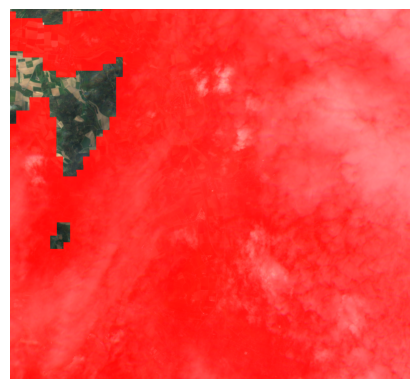

In [163]:
es = load_eval_script("evalscripts/es_true_color_clm.js")

request_image = SentinelHubRequest(
    evalscript = es,
    input_data = [
        SentinelHubRequest.input_data(
            data_collection = DataCollection.SENTINEL2_L2A,
            time_interval = ts,
        )
    ],
    responses = [SentinelHubRequest.output_response("default", MimeType.TIFF)],
    bbox = bbox,
    size = bbox_size,
    config = CONFIG,
)
imgs_clm = request_image.get_data()
img_clm =  imgs_clm[0]
import matplotlib.pyplot as plt
plt.imshow(img_clm)
plt.axis('off')  # Turn off axis labels and ticks for a cleaner image display
plt.show()

In [183]:
def extract_rgb(img):
    factor = 4.5
    n_rows = img.shape[0]
    n_cols = img.shape[1]
    n_bands = img.shape[2]
    out_shape = (img.shape[0], img.shape[1], 3)
    img_out = np.empty(out_shape, dtype=float) 
    for row_idx in range(n_rows):
        for col_idx in range(n_cols):
            b02 = img[row_idx][col_idx][1] # blue
            b03 = img[row_idx][col_idx][2] # green
            b04 = img[row_idx][col_idx][3] # red

            img_out[row_idx][col_idx] = [min(factor * b04, 255), min(factor * b03, 255), min(factor * b02, 255)]
    
    return img_out.astype(np.uint8)


In [166]:
def extract_clm(img):
    factor = 4.5
    n_rows = img.shape[0]
    n_cols = img.shape[1]
    n_bands = img.shape[2]
    out_shape = (img.shape[0], img.shape[1], 3)
    img_out = np.empty(out_shape, dtype=float) 
    for row_idx in range(n_rows):
        for col_idx in range(n_cols):
            b02 = img[row_idx][col_idx][1] # blue
            b03 = img[row_idx][col_idx][2] # green
            b04 = img[row_idx][col_idx][3] # red
            clm = img[row_idx][col_idx][12] # CLM
            if clm == 1.0: # cloudy
                img_out[row_idx][col_idx] = [255, 0, 0]
            elif clm == 255.0: # no data
                img_out[row_idx][col_idx] = [0, 0, 0]
            else: # clear
                img_out[row_idx][col_idx] = [255, 255, 255]
    
    return img_out

In [ ]:
def predict_bua(b01, b02, b03, b04, ndvi, ndwi, ndvi_green, ndvi_re1, ndvi_re2, nbsi, cl_green, sti):
    pass
    return bldg_proba

def extract_bua(img):
    factor = 4.5
    n_rows = img.shape[0]
    n_cols = img.shape[1]
    n_bands = img.shape[2]
    out_shape = (img.shape[0], img.shape[1], 3)
    img_out = np.empty(out_shape, dtype=float) 
    for row_idx in range(n_rows):
        for col_idx in range(n_cols):
            b01 = img[row_idx][col_idx][0] # Coastal aerosol
            b02 = img[row_idx][col_idx][1] # blue
            b03 = img[row_idx][col_idx][2] # green
            b04 = img[row_idx][col_idx][3] # red
            b05 = img[row_idx][col_idx][4]  # vegetation red edge
            b06 = img[row_idx][col_idx][5]  # red edge
            b07 = img[row_idx][col_idx][6]
            b08 = img[row_idx][col_idx][7]
            b11 = img[row_idx][col_idx][10]
            b12 = img[row_idx][col_idx][11]
        
            ndvi = (b08 - b04)/(b08 + b04)
            ndvi = (b08 - b04)/(b08 + b04)
            ndvi_re1 = (b08 - b05)/(b08 + b05)
            ndvi_re2 = (b08 - b06)/(b08 + b06)
            ndvi_green = (b08 - b03)/(b08 + b03)
            nbsi = (b11 + b04 - (b08 + b02))/(b11 + b04 + (b08 + b02))
            cl_green = b07/b03 - 1
            ndwi = (b03 - b08)/(b03 + b08)
            sti = b11 / b12

            bldg_proba = predict_bua(b01/1.e4, b02/1.e4, b03/1.e4, b04/1.e4, ndvi ,ndwi, ndvi_green, ndvi_re1, ndvi_re2, nbsi, cl_green, sti)

            img_out[row_idx][col_idx] = [min(factor * b04, 255), min(factor * b03, 255), min(factor * b02, 255)]
    
    return img_out.astype(np.uint8)



In [6]:
def plot_images(images: list, titles: list):
    
    fig, axes = plt.subplots(1, len(images), figsize=(15, 5))  # Create a figure and a set of 3 subplots
    for i in range(len(images)):
        axes[i].imshow(images[i])
        axes[i].set_title(titles[i])
        axes[i].axis('off')
    

    plt.tight_layout()  # Adjust layout to prevent titles from overlapping
    plt.show()


In [30]:
print(aoi_catalog)

{'0000': {'2025-04-20T10:37:59Z': [98.71], '2025-04-20T10:27:50Z': [97.41], '2025-04-18T10:38:06Z': [98.7], '2025-04-17T10:28:01Z': [99.92], '2025-04-15T10:28:09Z': [87.62], '2025-04-13T10:37:48Z': [87.45], '2025-04-10T10:37:59Z': [53.73], '2025-04-10T10:27:51Z': [66.72], '2025-04-08T10:38:08Z': [16.66], '2025-04-07T10:28:01Z': [0.0], '2025-04-05T10:28:12Z': [0.74], '2025-04-03T10:37:44Z': [30.02], '2025-03-31T10:37:55Z': [74.31], '2025-03-31T10:27:49Z': [82.82], '2025-03-29T10:38:07Z': [99.72], '2025-03-28T10:27:57Z': [81.49], '2025-03-26T10:28:10Z': [99.41], '2025-03-24T10:37:48Z': [72.94], '2025-03-19T10:38:09Z': [0.04], '2025-03-18T10:28:01Z': [0.88], '2025-03-16T10:28:12Z': [98.72], '2025-03-14T10:37:47Z': [99.15], '2025-03-11T10:27:51Z': [49.0], '2025-03-09T10:38:09Z': [25.05], '2025-03-06T10:28:13Z': [0.0], '2025-03-04T10:37:48Z': [2.23], '2025-03-01T10:27:52Z': [80.02]}, '0001': {'2025-04-20T10:37:59Z': [98.71], '2025-04-20T10:27:50Z': [97.41], '2025-04-18T10:38:06Z': [98.7], '

In [19]:
def get_image(es, ts, bbox, bbox_size, config):
    request_image = SentinelHubRequest(
        evalscript=es,
        input_data=[
            SentinelHubRequest.input_data(
                data_collection=DataCollection.SENTINEL2_L2A,
                time_interval=ts,
            )
        ],
        responses=[SentinelHubRequest.output_response("default", MimeType.TIFF)],
        bbox=bbox,
        size=bbox_size,
        config=config,
    )
    imgs = request_image.get_data()
    img = imgs[0]
    return img

In [ ]:
id = '0000'
res = 10
bbox = aoi_bbox_dict[id]
bbox_size = bbox_to_dimensions(bbox, resolution=res)
images = []
titles = []
indexes = []
es_clm = load_eval_script("evalscripts/es_true_color_clm.js")
es_rgb = load_eval_script("evalscripts/es_standard.js")
es_ab = load_eval_script("evalscripts/es_all_bands_clm.js")
for timestamp in section.keys():
    ts = str(timestamp)[:10] # extract date: 2025-04-20T10:37:59Z -> 2025-04-20
    img_clm = get_image(es_clm, ts, bbox, bbox_size, config = CONFIG)
    img_rgb = get_image(es_rgb, ts, bbox, bbox_size, config = CONFIG)
    index = section[timestamp]    
    indexes.append(index)
    images.append([img_rgb, img_clm])


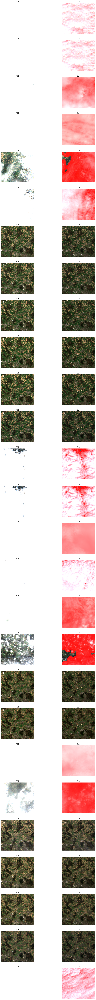

In [160]:
titles = ['RGB', 'CLM']
plot_images_2(images, indexes, titles)

In [ ]:
#print(img.shape)
print("h [n_rows] : ", img.shape[0])
print("w [n_cols] : ", img.shape[1])
print("d [n_bands]: ", img.shape[2])
# get n'th row / column
n = 0
row_n = img[n]
column_n = img[:,n]
# get n,m'th pixel
n = 0
m = 0
pixel_n_m = img[n][m]

h [n_rows] :  893
w [n_cols] :  965
d [n_bands]:  13


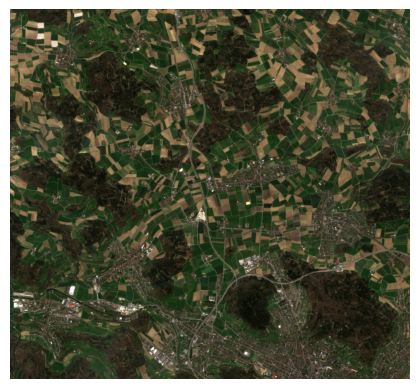

In [156]:
import matplotlib.pyplot as plt
plt.imshow(img_clm)
plt.axis('off')  # Turn off axis labels and ticks for a cleaner image display
plt.show()

In [20]:
import numpy as np
import json
import subprocess

def apply_evalscript(image: np.ndarray, script_path: str) -> np.ndarray:
    assert image.shape[2] == 13, "Expected 13-band image"
    h, w, _ = image.shape

    input_data = {
        "width": w,
        "height": h,
        "pixels": image.tolist()
    }

    with open("input_image.json", "w") as f:
        json.dump(input_data, f)

    subprocess.run(["node", "eval_runner.js", "input_image.json", script_path], check=True)

    with open("output.json", "r") as f:
        output_data = json.load(f)

    output_array = np.array(output_data["output"], dtype=np.uint16)

    return output_array


In [26]:
img_trans = apply_evalscript(img_all_bands, "evalscripts/es_standard.js")


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


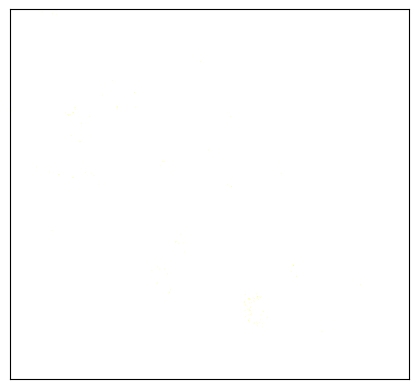

In [28]:
plot_image(img_trans)

In [ ]:
es = load_eval_script("evalscripts/es_all_bands_clm.js")

request_image = SentinelHubRequest(
    evalscript = es,
    input_data = [
        SentinelHubRequest.input_data(
            data_collection = DataCollection.SENTINEL2_L2A,
            time_interval = ts,
        )
    ],
    responses = [SentinelHubRequest.output_response("default", MimeType.TIFF)],
    bbox = bbox,
    size = bbox_size,
    config = CONFIG,
)
imgs_all_bands = request_image.get_data(decode_data=True)
img_all_bands =  imgs_all_bands[0]

#print(img_all_bands.shape)
img_all_bands

In [10]:
img_all_bands

array([[[11, 20, 30, ..., 72, 52,  0],
        [11, 24, 36, ..., 72, 52,  0],
        [11, 14, 22, ..., 55, 39,  0],
        ...,
        [ 8,  8, 17, ..., 44, 24,  0],
        [ 8, 11, 20, ..., 50, 30,  0],
        [ 8, 17, 24, ..., 50, 30,  0]],

       [[11, 21, 36, ..., 72, 52,  0],
        [11, 31, 37, ..., 72, 52,  0],
        [11, 12, 19, ..., 55, 39,  0],
        ...,
        [ 8,  7, 14, ..., 44, 24,  0],
        [ 8,  6, 15, ..., 50, 30,  0],
        [ 8,  8, 17, ..., 50, 30,  0]],

       [[11, 26, 35, ..., 64, 46,  0],
        [11, 27, 30, ..., 64, 46,  0],
        [11,  8, 14, ..., 45, 37,  0],
        ...,
        [ 8,  6, 14, ..., 42, 20,  0],
        [ 8,  7, 14, ..., 42, 23,  0],
        [ 8,  7, 15, ..., 42, 23,  0]],

       ...,

       [[ 4,  5, 13, ..., 40, 18,  0],
        [ 4,  5, 13, ..., 40, 18,  0],
        [ 4,  6, 14, ..., 41, 19,  0],
        ...,
        [24, 14, 21, ..., 94, 84,  0],
        [24, 13, 18, ..., 94, 84,  0],
        [24, 21, 27, ..., 71, 61

In [ ]:
print(imgs_all_bands)

[DownloadResponse(request=DownloadRequest(url='https://services.sentinel-hub.com/api/v1/process', headers={'content-type': 'application/json', 'accept': 'image/tiff'}, request_type=<RequestType.POST: 'POST'>, post_values={'input': {'bounds': {'properties': {'crs': 'http://www.opengis.net/def/crs/EPSG/0/4326'}, 'bbox': [8.629496, 47.5022965, 8.757201, 47.58301]}, 'data': [InputDataDict({'type': 'sentinel-2-l2a', 'dataFilter': {'timeRange': {'from': '2025-04-08T00:00:00Z', 'to': '2025-04-08T23:59:59Z'}}}, service_url=https://services.sentinel-hub.com)]}, 'evalscript': '//VERSION=3\nfunction setup() {\n    return {\n        input: [{\n            bands: [\n                "B01", // Coastal aerosol     | 442.7 nm  | 60 m\n                "B02", // Blue                | 492.4 nm  | 10 m\n                "B03", // Green               | 559.8 nm  | 10 m\n                "B04", // Red                 | 664.6 nm  | 10 m\n                "B05", // Vegetation red edge | 704.1 nm  | 20 m\n        

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


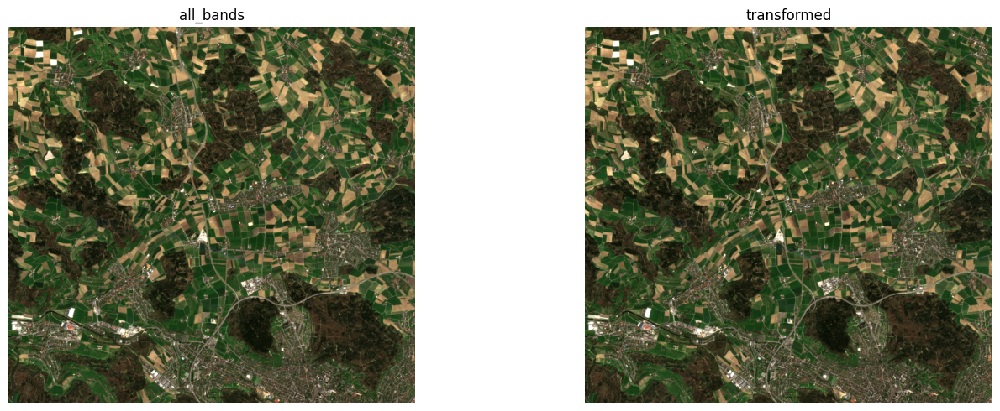

In [29]:
#plt.imshow(img_trans)
#plt.axis('off')  # Turn off axis labels and ticks for a cleaner image display
#plt.show()
plot_images(images = [img_rgbX, img_trans], titles = ['all_bands', 'transformed'])

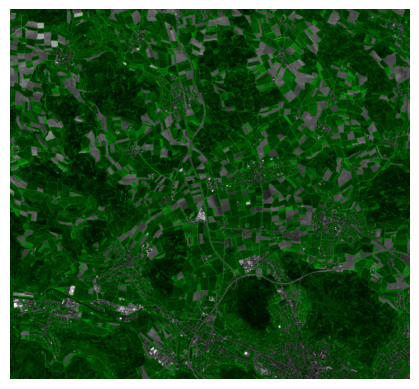

In [31]:
img_gc = get_image(es = load_eval_script("evalscripts/es_green_city.js"), ts =ts, bbox = bbox, bbox_size = bbox_size, config = CONFIG)
from matplotlib import pyplot as plt
plt.imshow(img_gc)
plt.axis('off')  # Turn off axis labels and ticks for a cleaner image display
plt.show()

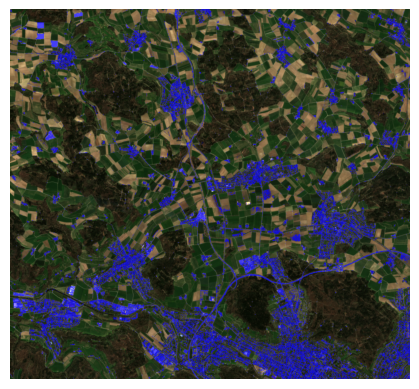

In [33]:
img_bua = get_image(es = load_eval_script("evalscripts/es_built-up_binary_classifier.js"), ts =ts, bbox = bbox, bbox_size = bbox_size, config = CONFIG)
from matplotlib import pyplot as plt
plt.imshow(img_bua)
plt.axis('off')  # Turn off axis labels and ticks for a cleaner image display
plt.show()

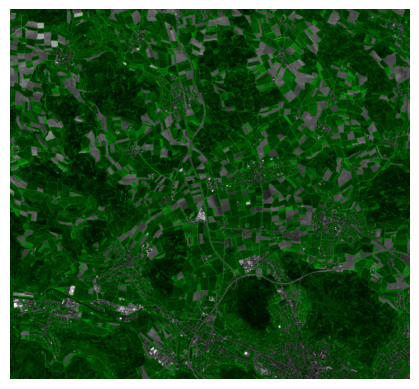

In [40]:
from matplotlib import pyplot as plt
plt.imshow(img_gc)
plt.axis('off')  # Turn off axis labels and ticks for a cleaner image display
plt.show()

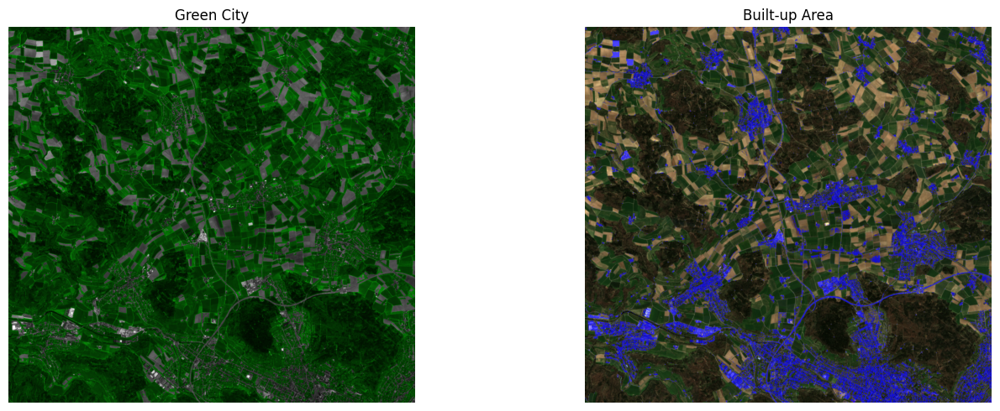

In [35]:
plot_images([img_gc, img_bua], ['Green City', 'Built-up Area'])

In [ ]:
def calculate_bua(image, blue_threshold=50, factor=3.5):
    """
    Calculate the proportion of red pixels in the image and visualize them.

    Parameters:
        image (ndarray): The satellite image with shape (H, W, 3).
        red_threshold (int): Minimum value of the red channel to consider a pixel as "red."
        factor (float): Minimum ratio of red to green/blue channels to consider a pixel as "red."

    Returns:
        float: Proportion of red pixels in the image.
    """
    # Split the image into its color channels
    red_channel = image[:, :, 0]
    green_channel = image[:, :, 1]
    blue_channel = image[:, :, 2]

    # Create a boolean mask for red pixels
    blue_pixels = (
        (blue_channel > blue_threshold)
        & (blue_channel > factor * red_channel)
        & (blue_channel > factor * green_channel)
    )

    # Count red pixels and calculate the proportion
    blue_count = np.sum(blue_pixels)
    total_pixels = image.shape[0] * image.shape[1]
    blue_proportion = blue_count / total_pixels

    # Create a visualization where red pixels are full-intensity red
    blue_visualization = np.zeros_like(image)  # Start with a black image
    blue_visualization[blue_pixels] = [
        255,
        0,
        0,
    ]  # Set red pixels to full red (255, 0, 0)
    return blue_proportion * 100


In [37]:
print(calculate_bua(img_bua))

9.457554148849137


In [ ]:
def calculate_ga(image, green_threshold=50, factor=3.5):
    """
    Calculate the proportion of red pixels in the image and visualize them.

    Parameters:
        image (ndarray): The satellite image with shape (H, W, 3).
        red_threshold (int): Minimum value of the red channel to consider a pixel as "red."
        factor (float): Minimum ratio of red to green/blue channels to consider a pixel as "red."

    Returns:
        float: Proportion of red pixels in the image.
    """
    # Split the image into its color channels
    red_channel = image[:, :, 0]
    green_channel = image[:, :, 1]
    blue_channel = image[:, :, 2]

    # Create a boolean mask for red pixels
    green_pixels = (
        (green_channel > green_threshold)
        & (green_channel > factor * red_channel)
        & (green_channel > factor * blue_channel)
    )

    # Count red pixels and calculate the proportion
    green_count = np.sum(green_pixels)
    total_pixels = image.shape[0] * image.shape[1]
    green_proportion = green_count / total_pixels

    # Create a visualization where red pixels are full-intensity red
    green_visualization = np.zeros_like(image)  # Start with a black image
    green_visualization[green_pixels] = [
        255,
        0,
        0,
    ]  # Set red pixels to full red (255, 0, 0)
    return green_proportion * 100

In [39]:
print(calculate_ga(img_gc))

52.58191228263581
